
# Preprocessing - SCT & Scran Normalization
Michael Sterr

2021-09-25 19:42:53      


# Setup

Run following scripts before:
 * 4-X_scMultiome_FVF-Gut_Preprocessing_Doublet-Detection_XXX-XXX_v1

In [1]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:85% !important; }</style>"))

In [2]:
# General
import scipy as sci
import numpy as np
import pandas as pd
import logging
import time
import pickle
from itertools import chain

#R
import rpy2
import rpy2.rinterface_lib.callbacks
from rpy2.robjects import pandas2ri
import anndata2ri

# Plotting
import matplotlib.pyplot as plt
import matplotlib as mpl
from matplotlib import rcParams
from matplotlib import cm
import seaborn as sb

# Analysis
import scanpy as sc
import scvelo as scv

RuntimeError: module compiled against API version 0xe but this version of numpy is 0xd

In [3]:
# Settings

## Scanpy settings
sc.settings.verbosity = 3
sc.logging.print_versions()

## ScVelo settings
scv.settings.verbosity = 3
scv.logging.print_versions()

## R settings
### Ignore R warning messages
#### Note: this can be commented out to get more verbose R output
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

### Automatically convert rpy2 outputs to pandas dataframes
pandas2ri.activate()
anndata2ri.activate()
%load_ext rpy2.ipython

The `sinfo` package has changed name and is now called `session_info` to become more discoverable and self-explanatory. The `sinfo` PyPI package will be kept around to avoid breaking old installs and you can downgrade to 0.3.2 if you want to use it without seeing this message. For the latest features and bug fixes, please install `session_info` instead. The usage and defaults also changed slightly, so please review the latest README at https://gitlab.com/joelostblom/session_info.
-----
anndata     0.7.6
scanpy      1.8.1
sinfo       0.3.4
-----
PIL                         8.3.2
anndata2ri                  1.0.6
backcall                    0.2.0
backports                   NA
beta_ufunc                  NA
binom_ufunc                 NA
cffi                        1.14.6
cloudpickle                 2.0.0
colorama                    0.4.4
cycler                      0.10.0
cython_runtime              NA
dask                        2021.09.0
dateutil                    2.8.2
debugpy      

ERROR: XMLRPC request failed [code: -32500]
RuntimeError: PyPI's XMLRPC API is currently disabled due to unmanageable load and will be deprecated in the near future. See https://status.python.org/ for more information.


In [4]:
# Color maps
exec(open("/home/michi/Software/viscm/maps/michi_bk_bl_gn_yl.py").read())

In [5]:
# Plot settings
%matplotlib inline

## Directory
sc.settings.figdir='/home/michi/Projects/scMultiome_NVF_Mouse-Pancreas-Development_E14.5_Notebooks/Figures'

## Plotting parameters
rcParams['figure.figsize']=(20,20) #rescale figures
#sc.set_figure_params(scanpy=True, frameon=False, vector_friendly=False, color_map='tab10' ,transparent=True, dpi=150, dpi_save=300)
sc.set_figure_params(scanpy=True, frameon=False, vector_friendly=False ,transparent=True, dpi=150, dpi_save=300)

## Font
rcParams['font.family'] = 'sans-serif'
rcParams['font.sans-serif'] = ['Source Sans 3']

## Grid & Ticks
rcParams['grid.alpha'] = 0
rcParams['xtick.bottom'] = True
rcParams['ytick.left'] = True

## Embed font
plt.rc('pdf', fonttype=42)

## Define new default settings
plt.rcParamsDefault = plt.rcParams

# Load Data

In [6]:
adata=sc.read('/home/michi/Projects/scMultiome_NVF_Mouse-Pancreas-Development_E14.5_Notebooks/Files/E14-E15_adata_filtered_markedDoublets.h5ad')
adata_wsnn=sc.read('/home/michi/Projects/scMultiome_NVF_Mouse-Pancreas-Development_E14.5_Notebooks/Files/E14-E15_adata_filtered_markedDoublets_sctNormalized_wsnn')
adata_wknn=sc.read('/home/michi/Projects/scMultiome_NVF_Mouse-Pancreas-Development_E14.5_Notebooks/Files/E14-E15_adata_filtered_markedDoublets_sctNormalized_wknn')

# Normalization with Scran

In [7]:
#Perform a clustering for scran normalization in clusters
adata_pp = adata.copy()
sc.pp.normalize_total(adata_pp, target_sum=1e6)#, exclude_highly_expressed=True) #sc.pp.normalize_per_cell(adata_pp, counts_per_cell_after=1e6)
sc.pp.log1p(adata_pp)
sc.pp.pca(adata_pp)
sc.pp.neighbors(adata_pp)
sc.tl.leiden(adata_pp, key_added='groups', resolution=0.5) #sc.tl.louvain(adata_pp, key_added='groups', resolution=0.5)

normalizing counts per cell
    finished (0:00:00)
computing PCA
    with n_comps=50
    finished (0:00:11)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:12)
running Leiden clustering
    finished: found 12 clusters and added
    'groups', the cluster labels (adata.obs, categorical) (0:00:01)


In [8]:
#Preprocess variables for scran normalization
input_groups = adata_pp.obs['groups']
data_mat = adata.X.T

In [9]:
%%R -i data_mat -i input_groups -o size_factors

library(scran)
size_factors = calculateSumFactors(data_mat, clusters=input_groups, min.mean=0.1)

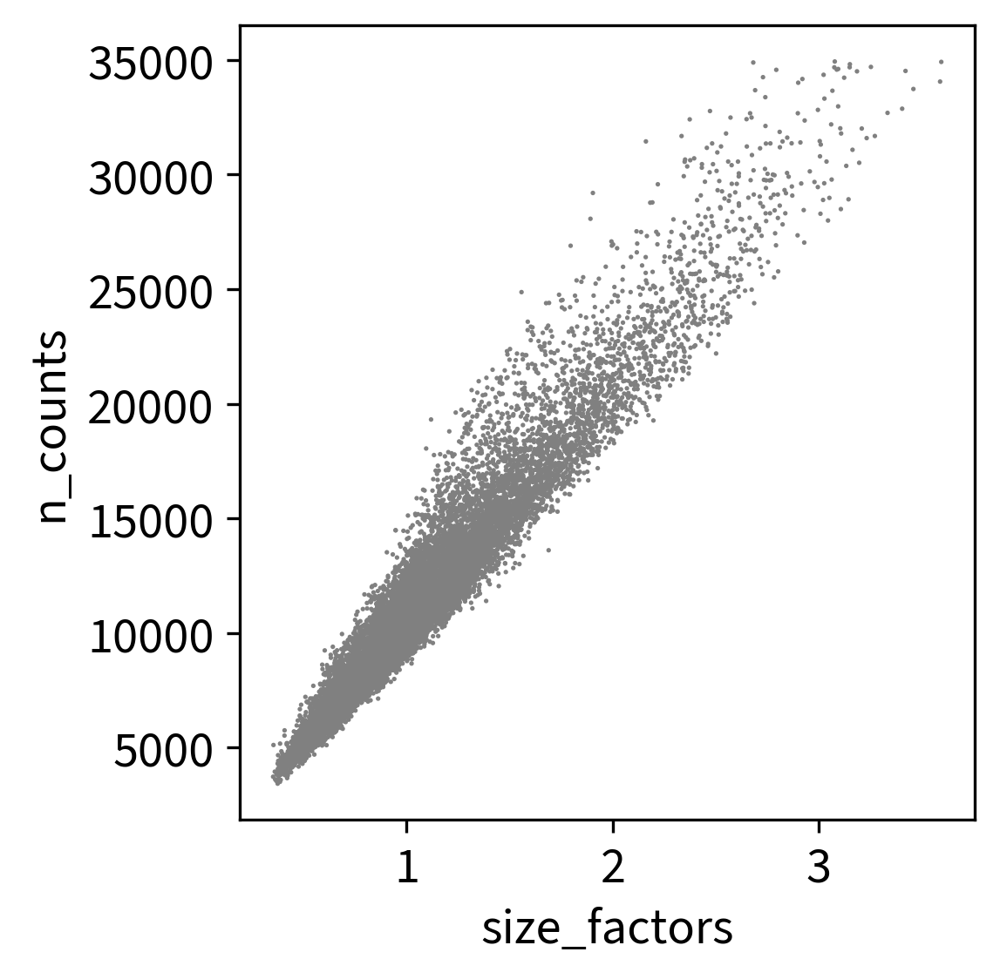

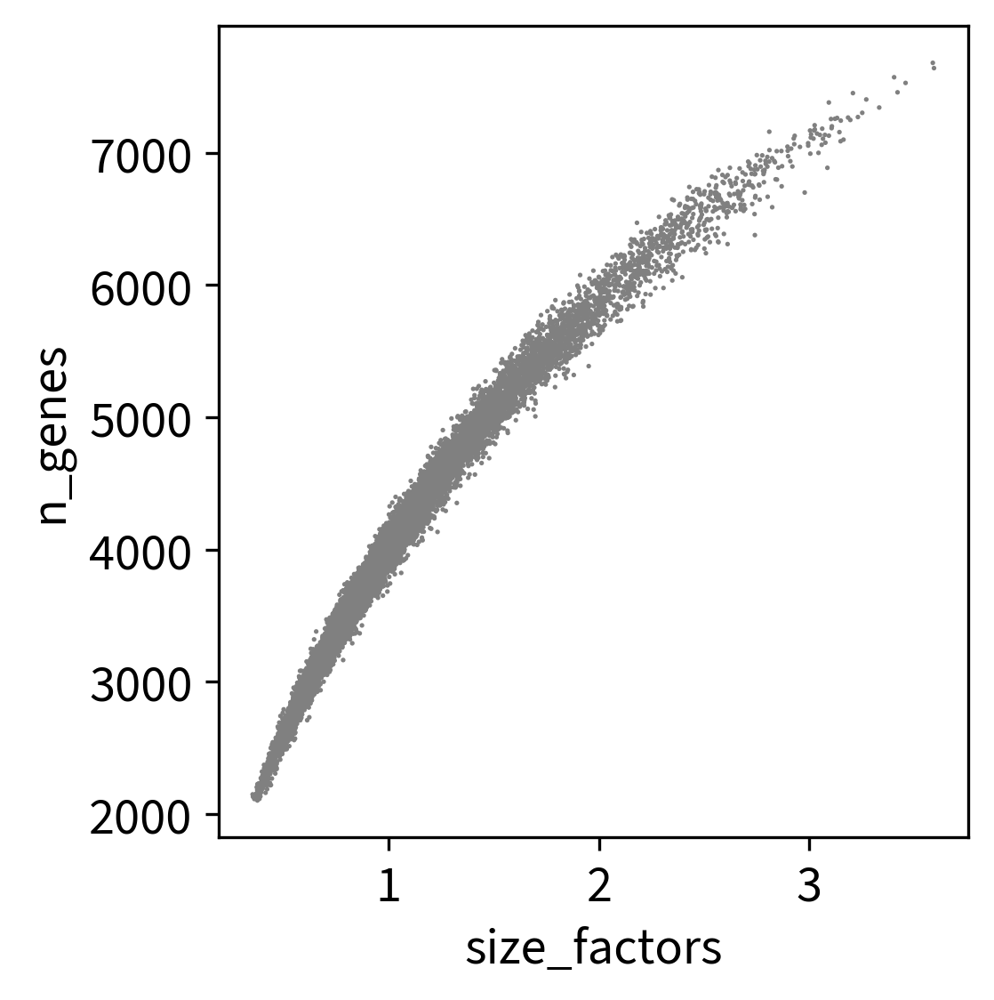

<AxesSubplot:ylabel='Density'>

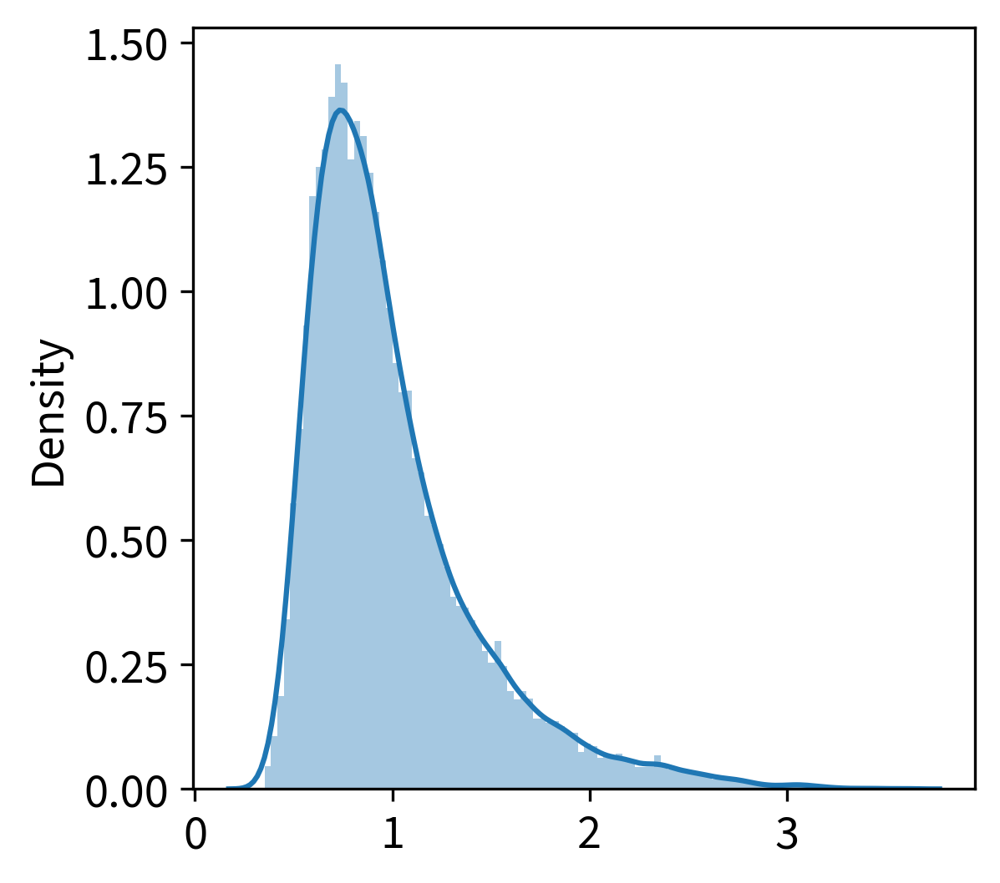

In [10]:
# Visualize the estimated size factors
adata.obs['size_factors'] = size_factors

sc.pl.scatter(adata, 'size_factors', 'n_counts')
sc.pl.scatter(adata, 'size_factors', 'n_genes')

sb.distplot(size_factors, bins=100, kde=True)

In [11]:
#Keep the count data in a counts layer
adata.layers['raw_counts'] = adata.X.copy()

#Logarithmize raw counts
adata.layers['log_raw_counts'] = sc.pp.log1p(adata.layers['raw_counts'])

In [12]:
#Normalize adata 
adata.X /= adata.obs['size_factors'].values[:,None]
sc.pp.log1p(adata)

#Keep the normalized count data in a counts layer
adata.layers['scran_counts'] = adata.X.copy()

# Add Normalization from Seurat SCT 

Loading SCT normalized date without doublets.

Run following scripts before:
 * 7_scMultiome_FVF-Gut_Preprocessing_SCT-WNN.rmd

In [13]:
%%R -o adata_sct

adata_sct <- readRDS('/home/michi/Projects/scMultiome_NVF_Mouse-Pancreas-Development_E14.5_Notebooks/Files/E14-E15_adata_filtered_markedDoublets_sctNormalized_sce.rds')

In [14]:
adata_sct.layers['sct_counts'] = adata_sct.X.copy()

In [15]:
# Harmonize features
adata = adata[:,adata_sct.var_names].copy()

In [16]:
# Add SCT data
adata.layers['sct_counts'] = adata_sct.layers['sct_counts']
adata.layers['sct_logcounts'] = adata_sct.layers['sct_logcounts']
adata.layers['sct_scale_data'] = adata_sct.layers['sct_scale_data']
adata.var[['sct.detection_rate', 'sct.gmean', 'sct.variance', 'sct.residual_variance', 'sct.variable']] = adata_sct.var[['sct.detection_rate', 'sct.gmean', 'sct.variance', 'sct.residual_variance', 'sct.variable']]

In [17]:
# Put X in a layer to keep it after merging
adata_sct.layers['sct_counts'] = adata_sct.X.copy()

# Keep raw QC metrics & counts
adata.obs['mt_frac_raw'] = adata.obs['mt_frac']
adata.obs['rp_frac_raw'] = adata.obs['rp_frac']
adata.obs['n_genes_raw'] = adata.obs['n_genes']
adata.obs['log_genes_raw'] = adata.obs['log_genes']
adata.obs['n_counts_raw'] = adata.obs['n_counts']
adata.obs['log_counts_raw'] = adata.obs['log_counts']
#adata.layers['raw_counts'] = adata.X

# Add SCT data
adata.layers['sct_counts'] = adata_sct.layers['sct_counts']
adata.layers['sct_logcounts'] = adata_sct.layers['sct_logcounts']
adata.layers['sct_scale_data'] = adata_sct.layers['sct_scale_data']
adata.var[['sct.detection_rate', 'sct.gmean', 'sct.variance', 'sct.residual_variance', 'sct.variable']] = adata_sct.var[['sct.detection_rate', 'sct.gmean', 'sct.variance', 'sct.residual_variance', 'sct.variable']]

# Set normalized counts as X for QC metrics
adata.X = adata.layers['sct_counts']
adata.X=adata.X.toarray()

# Filter genes: Min 20 cells - filters out 0 count genes
sc.pp.filter_genes(adata, min_cells=20)
print('Number of genes after cell filter: {:d}'.format(adata.n_vars))

filtered out 4004 genes that are detected in less than 20 cells
Number of genes after cell filter: 14745


In [18]:
# Quality control - calculate QC covariates
adata.obs['n_counts'] = adata.X.sum(1)
adata.obs['log_counts'] = np.log(adata.obs['n_counts'])
adata.obs['n_genes'] = (adata.X > 0).sum(1)
adata.obs['log_genes'] = np.log(adata.obs['n_genes'])

mt_gene_mask = [gene.startswith('mt-') for gene in adata.var_names]
adata.obs['mt_frac'] = adata.X[:, mt_gene_mask].sum(1)/adata.obs['n_counts']

rp_gene_mask = [gene.startswith(('Rps','Rpl')) for gene in adata.var_names]
adata.obs['rp_frac'] = adata.X[:,rp_gene_mask].sum(1) / adata.X.sum(1)

In [19]:
# Set log-normalized counts as X
adata.X = adata.layers['sct_logcounts']
adata.X=adata.X.toarray()

# Store the full data set in 'raw' as log-normalized data for statistical testing
adata.raw = adata

In [20]:
# Calc umap & trimap
hvgs = pd.Series(adata.var['sct.variable'][adata.var['sct.variable'] > 0].index) # use HVGs from sct
adata.var['highly_variable']= False
adata.var['highly_variable'][hvgs] = True

sc.pp.pca(adata, svd_solver='arpack', use_highly_variable=True)
sc.pp.neighbors(adata, metric='correlation', n_neighbors=20, n_pcs=30)
sc.tl.leiden(adata, resolution=0.5)

sc.tl.umap(adata)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:03)
computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:06)
running Leiden clustering
    finished: found 12 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:01)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:07)


In [21]:

print('\n','Number of highly variable genes: {:d}'.format(np.sum(adata.var['highly_variable'])))

#sc.pl.highly_variable_genes(adata)


 Number of highly variable genes: 1984


# Add WNN Graph

In [22]:
# Harmonize vars
adata_wsnn = adata_wsnn[:,adata_wsnn.var_names.isin(adata.var_names)].copy()

In [23]:
adata.uns['neighbors_wnn'] = adata_wsnn.uns['neighbors'].copy()

In [24]:
adata.uns['neighbors_wnn']['connectivities'] = adata_wknn.uns['neighbors']['distances'].copy()

In [25]:
adata.uns['neighbors_wnn']['connectivities_key'] = 'connectivities'
adata.uns['neighbors_wnn']['distances_key'] = 'distances'
adata.uns['neighbors_wnn']['params'] = {'method': 'wsnn', 'metric': 'correlation', 'n_neighbors': 20}

In [26]:
adata.obsm['X_umap_wsnn'] = adata_wsnn.obsm['X_umap'].copy()
adata.obsm['X_pca_wsnn'] = adata_wsnn.obsm['X_pca'].copy()
adata.obsm['X_spca_wsnn'] = adata_wsnn.obsm['X_spca'].copy()

In [27]:
adata.varm['PCs_wsnn'] = adata_wsnn.varm['PCs'].copy()
adata.varm['SPCA_wsnn'] = adata_wsnn.varm['SPCA'].copy()

# Save

In [28]:
# Save
sc.write('/home/michi/Projects/scMultiome_NVF_Mouse-Pancreas-Development_E14.5_Notebooks/Files/E14-E15_adata_filtered_markedDoublets_sctNormalized_WNN', adata)

# Compare Results

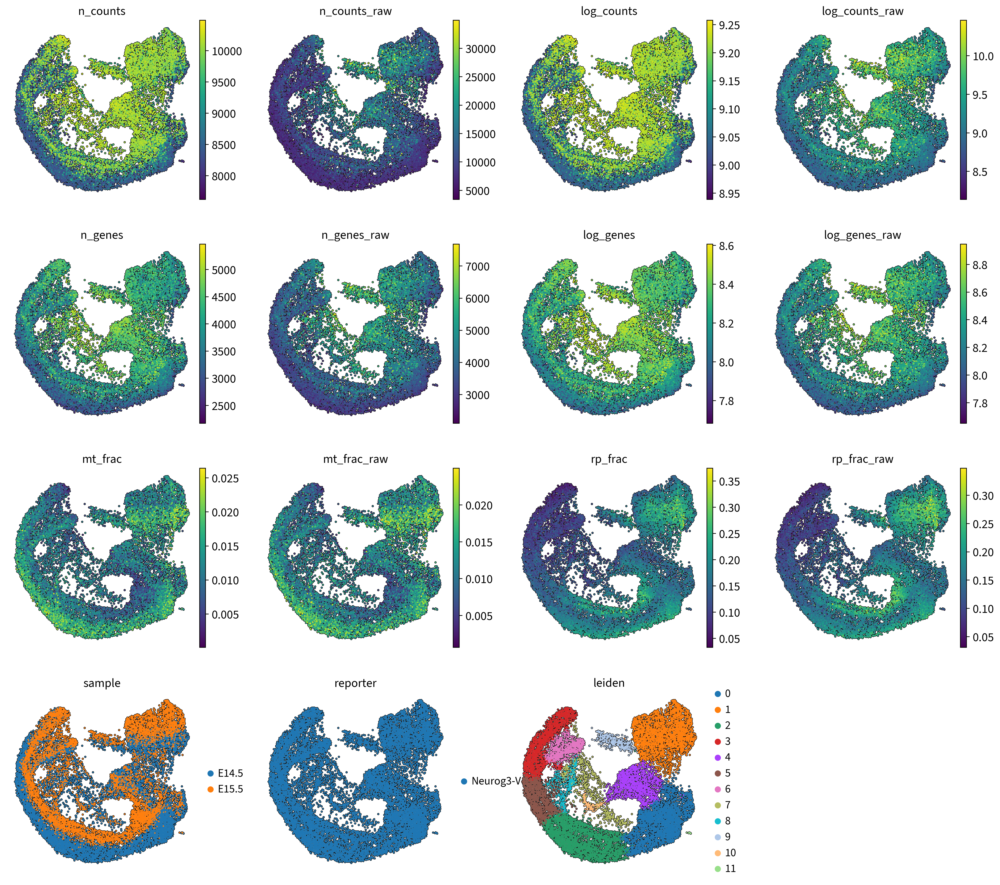

In [29]:
sc.pl.umap(adata, color=['n_counts', 'n_counts_raw', 'log_counts', 'log_counts_raw','n_genes','n_genes_raw','log_genes','log_genes_raw','mt_frac','mt_frac_raw','rp_frac','rp_frac_raw','sample','reporter','leiden'], size=10, add_outline=True, alpha=1, outline_width=(0.3, 0.0), ncols=4)

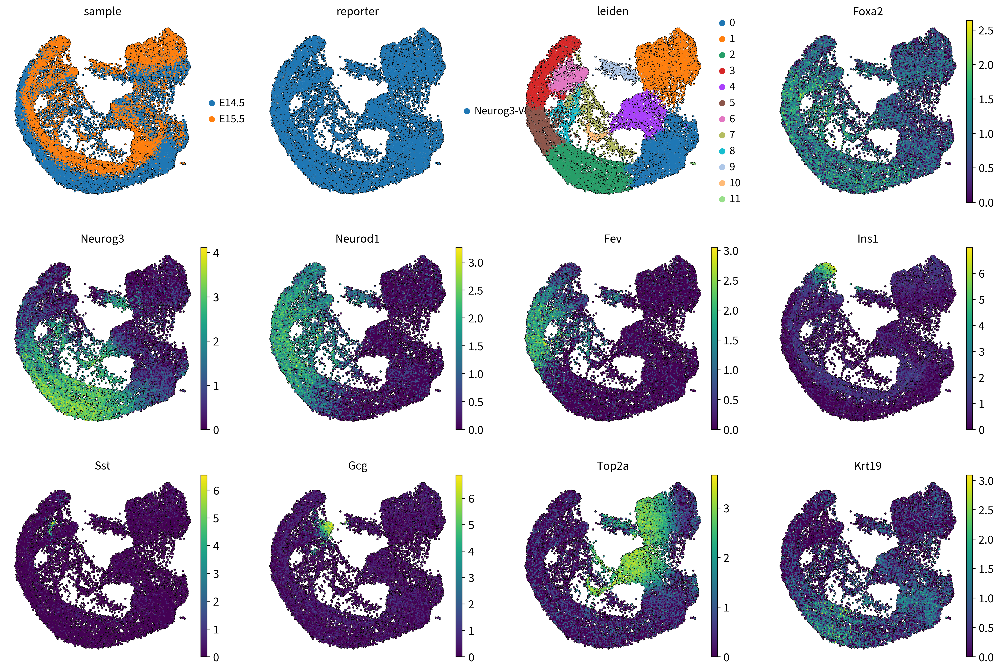

In [30]:
sc.pl.umap(adata, color=['sample','reporter','leiden','Foxa2','Neurog3','Neurod1','Fev','Ins1','Sst','Gcg','Top2a','Krt19'], size=10, add_outline=True, alpha=1, outline_width=(0.3, 0.0), ncols=4)

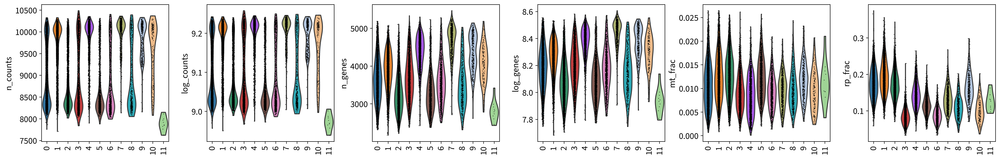

In [31]:
sc.pl.violin(adata, use_raw=False, keys=['n_counts', 'log_counts','n_genes','log_genes','mt_frac','rp_frac'], groupby='leiden', rotation=90)

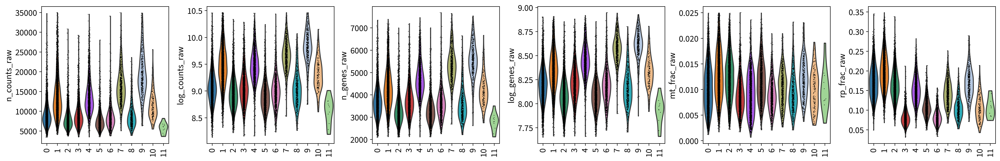

In [32]:
sc.pl.violin(adata, use_raw=False, keys=['n_counts_raw', 'log_counts_raw','n_genes_raw','log_genes_raw','mt_frac_raw','rp_frac_raw'], groupby='leiden', rotation=90)

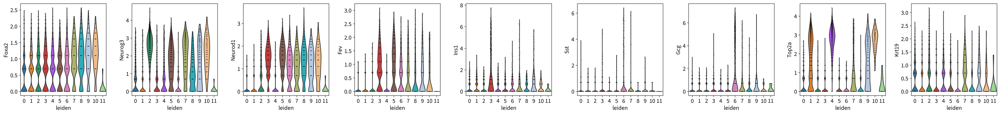

In [33]:
sc.pl.violin(adata, use_raw=False, keys=['Foxa2','Neurog3','Neurod1','Fev','Ins1','Sst','Gcg','Top2a','Krt19'], groupby='leiden', layer='raw_counts')

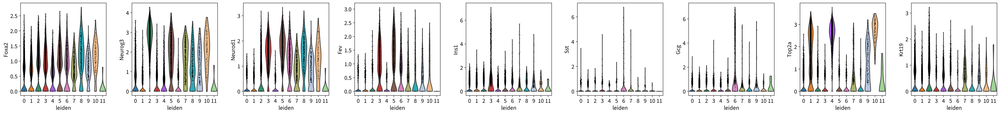

In [34]:
sc.pl.violin(adata, use_raw=False, keys=['Foxa2','Neurog3','Neurod1','Fev','Ins1','Sst','Gcg','Top2a','Krt19'], groupby='leiden', layer='scran_counts')

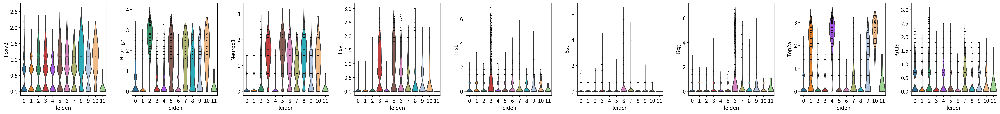

In [35]:
sc.pl.violin(adata, use_raw=False, keys=['Foxa2','Neurog3','Neurod1','Fev','Ins1','Sst','Gcg','Top2a','Krt19'], groupby='leiden')

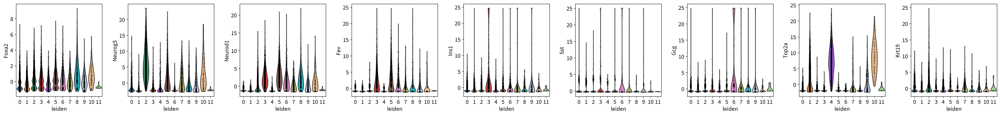

In [36]:
sc.pl.violin(adata, use_raw=False, keys=['Foxa2','Neurog3','Neurod1','Fev','Ins1','Sst','Gcg','Top2a','Krt19'], groupby='leiden', layer='sct_scale_data')

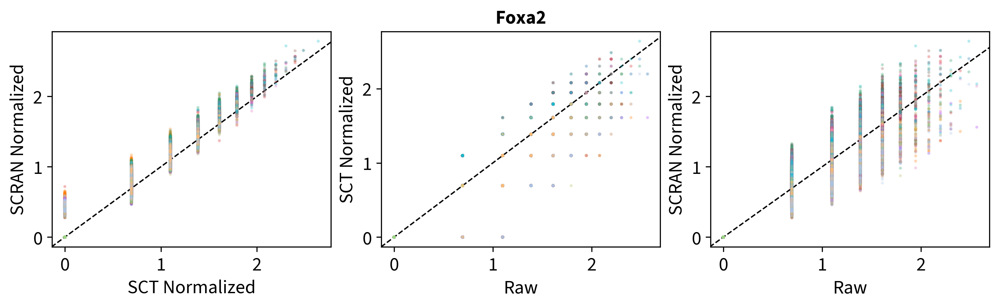

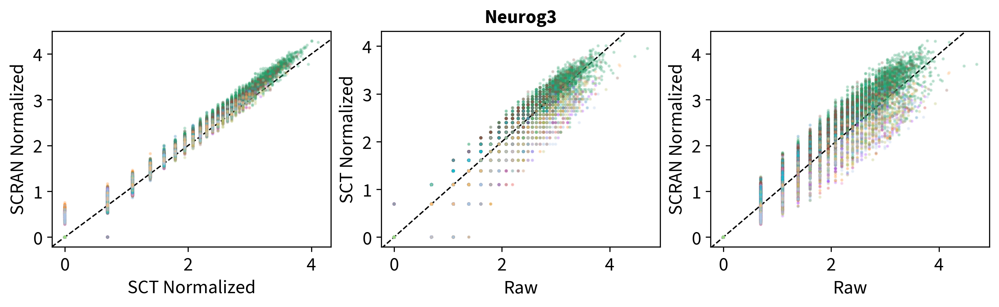

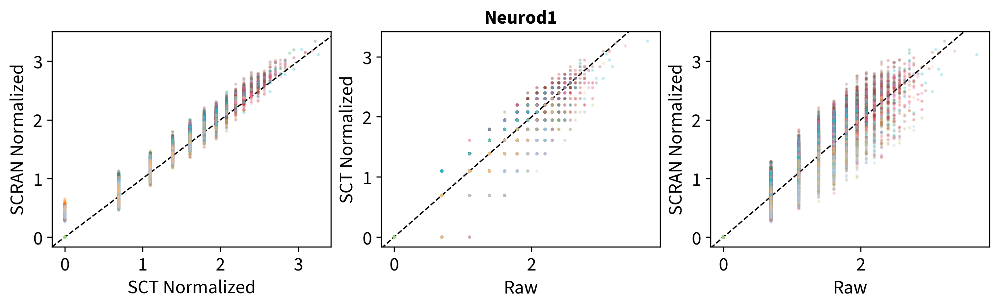

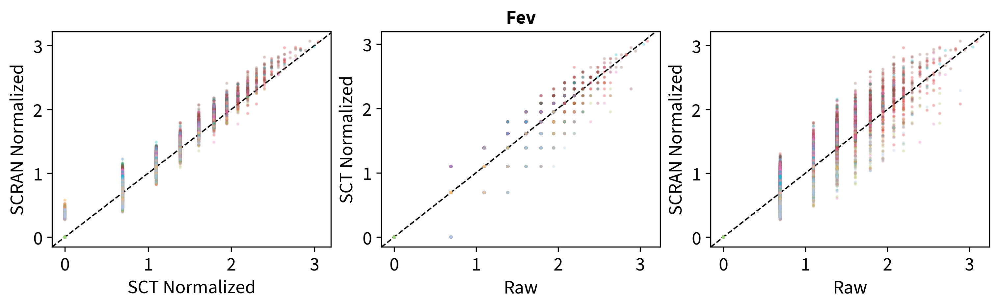

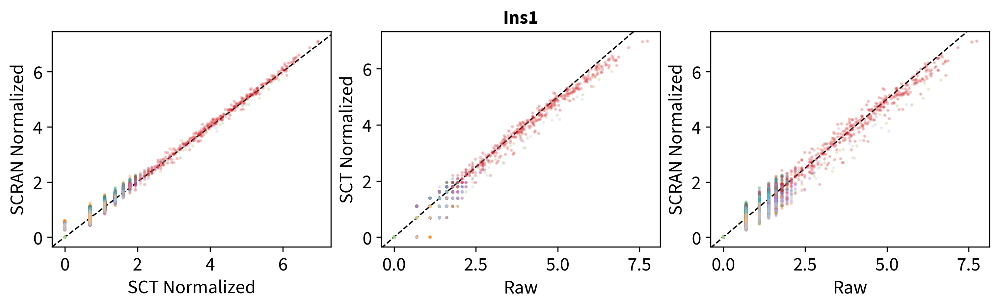

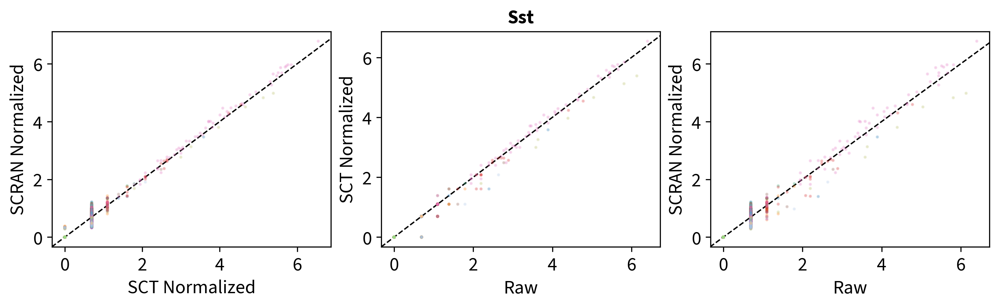

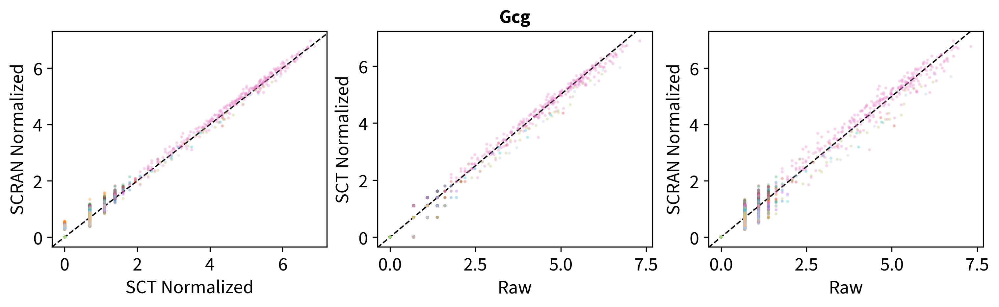

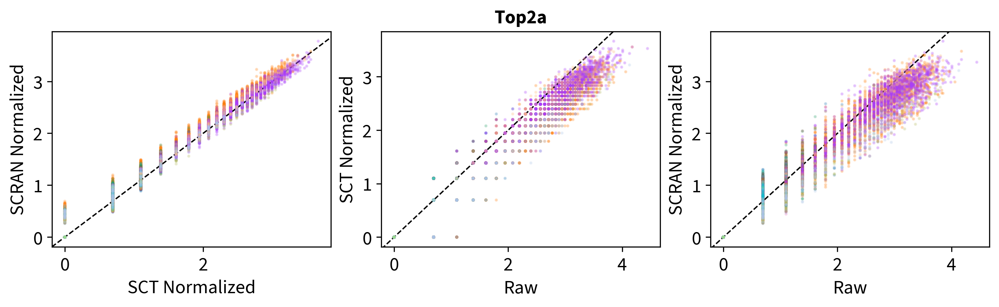

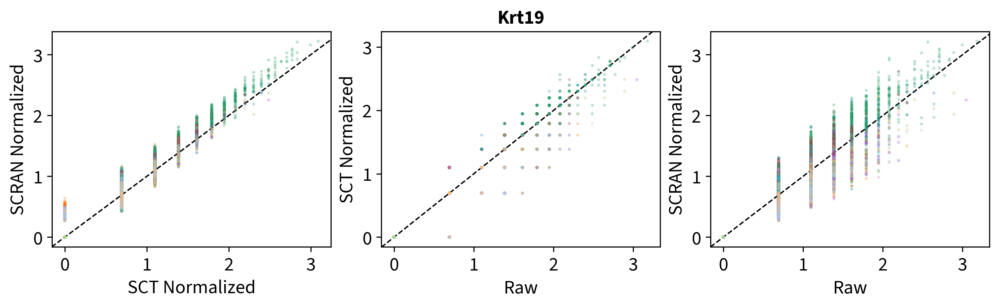

In [37]:
genes = ['Foxa2','Neurog3','Neurod1','Fev','Ins1','Sst','Gcg','Top2a','Krt19']
for gene in genes:
    df = pd.DataFrame({'sct':list(chain.from_iterable(adata[:,gene].layers['sct_logcounts'].toarray())), 'scran':list(chain.from_iterable(adata[:,gene].layers['scran_counts'].toarray())), 'raw':list(chain.from_iterable(adata[:,gene].layers['log_raw_counts'].toarray())), 'leiden':list(adata.obs['leiden'].astype(int))})
    df = df.sort_values(by=['leiden'])
    df.loc[:,'leiden'] = df.loc[:,'leiden'].astype('category')
    lims_x = []
    lims_y = []
    lims_line = []

    fig, axs = plt.subplots(1, 3, constrained_layout=True, figsize=(10, 3))
    # Plots
    axs[0].scatter(df.loc[:,'sct'], y=df.loc[:,'scran'], s=2, alpha=0.2, c=df.loc[:,'leiden'], cmap=ListedColormap(adata.uns['leiden_colors']))
    axs[1].scatter(df.loc[:,'raw'], y=df.loc[:,'sct'], s=2, alpha=0.2, c=df.loc[:,'leiden'], cmap=ListedColormap(adata.uns['leiden_colors']))
    axs[2].scatter(df.loc[:,'raw'], y=df.loc[:,'scran'], s=2, alpha=0.2, c=df.loc[:,'leiden'], cmap=ListedColormap(adata.uns['leiden_colors']))

    # Aesthetics
    for i,ax in enumerate(axs):
        lims_x.append(ax.get_xlim())
        lims_y.append(ax.get_ylim())
        lims_line.append([np.min([ax.get_xlim(), ax.get_ylim()]), np.max([ax.get_xlim(), ax.get_ylim()])])

    axs[0].set_xlabel('SCT Normalized')
    axs[0].set_ylabel('SCRAN Normalized')
    #axs[0].set_aspect('equal')
    axs[0].plot(lims_line[0], lims_line[0], 'k-', alpha=1, zorder=0, ls='--', lw=1)
    axs[0].set_xlim(lims_x[0])
    axs[0].set_ylim(lims_y[0])

    axs[1].set_xlabel('Raw')
    axs[1].set_ylabel('SCT Normalized')
    axs[1].set_title(gene, fontweight='bold')
    #axs[1].set_aspect('equal')
    axs[1].plot(lims_line[1], lims_line[1], 'k-', alpha=1, zorder=0, ls='--', lw=1)
    axs[1].set_xlim(lims_x[1])
    axs[1].set_ylim(lims_y[1])

    axs[2].set_xlabel('Raw')
    axs[2].set_ylabel('SCRAN Normalized')
    #axs[2].set_aspect('equal')
    axs[2].plot(lims_line[2], lims_line[2], 'k-', alpha=1, zorder=0, ls='--', lw=1)
    axs[2].set_xlim(lims_x[2])
    axs[2].set_ylim(lims_y[2])

    plt.show()

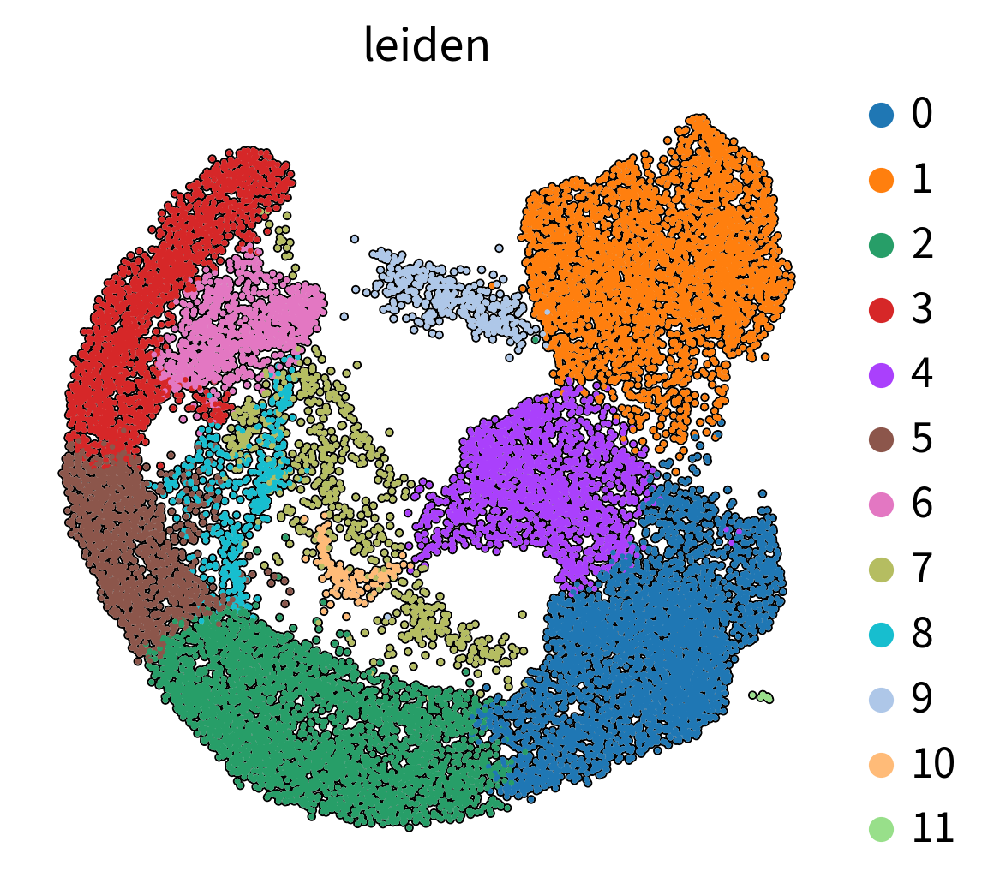

In [38]:
sc.pl.umap(adata, color=['leiden'], size=10, add_outline=True, alpha=1, outline_width=(0.3, 0.0), ncols=4)

In [39]:
%%R

sessionInfo()

R version 4.1.1 (2021-08-10)
Platform: x86_64-pc-linux-gnu (64-bit)
Running under: Ubuntu 20.04.4 LTS

Matrix products: default
BLAS:   /usr/lib/x86_64-linux-gnu/openblas-pthread/libblas.so.3
LAPACK: /usr/lib/x86_64-linux-gnu/openblas-pthread/liblapack.so.3

locale:
 [1] LC_CTYPE=en_US.UTF-8       LC_NUMERIC=C              
 [3] LC_TIME=de_DE.UTF-8        LC_COLLATE=en_US.UTF-8    
 [5] LC_MONETARY=de_DE.UTF-8    LC_MESSAGES=en_US.UTF-8   
 [7] LC_PAPER=de_DE.UTF-8       LC_NAME=C                 
 [9] LC_ADDRESS=C               LC_TELEPHONE=C            
[11] LC_MEASUREMENT=de_DE.UTF-8 LC_IDENTIFICATION=C       

attached base packages:
 [1] parallel  stats4    tools     stats     graphics  grDevices utils    
 [8] datasets  methods   base     

other attached packages:
 [1] scran_1.20.1                scuttle_1.2.0              
 [3] SingleCellExperiment_1.14.1 SummarizedExperiment_1.22.0
 [5] Biobase_2.52.0              GenomicRanges_1.44.0       
 [7] GenomeInfoDb_1.28.4         IR